In [1]:
# Importando módulos
import nltk
from nltk.corpus import stopwords
import numpy as np
import pandas as pd
import fitz
import re
import spacy
import seaborn as sns

from PIL import Image
import matplotlib.pyplot as plt
from wordcloud import WordCloud, ImageColorGenerator
from datetime import datetime as DateTime

# Configurando los estílos de los gráficos
plt.ioff()
sns.set_context('talk')
sns.set_style("whitegrid")

# Configurando los estílos de los gráficos
plt.ioff()
sns.set_context('talk')
sns.set_style("whitegrid")

In [2]:

_spanish_stopwords = stopwords.words('spanish') + ['ama', 'sua', 'llulla', 'quella', 'perú', 's/', 'si', 'año', 'años', 'país', 'peruano', 'https', 'gob', 'pe', 'p.','2020','2020a','2019', 'además', '2020.', '2018', '2020.', '--', 'así','2.','nº','1.','10','20','15','30','2017','100', '2020b', 'iii','según', 'http', 'pdf', '65', 'nacional', 'política', 'podemos', 'solo', 'sólo', 'ello', 'peruanos', 'mayor', '2021', 'fin', 'ley', 'plan', 'toda', 'todo', 'todas', 'todos', 'aquí', 'allá', 'entre', 'veces', 'menos', 'más', 'países', 'desarrollo', 'millones', 'mundo', 'salud', 'dejar', 'días', 'día', 'sistema', 'debe', 'objetivo', 'personas', 'propuesta', 'través' , 'tener', 'primeros', 'bibliografía', 'políticas', 'primero', 'segundo', 'tercero', 'covid-19', 'manera', 'pandemia', 'doctrina', 'gobierno', 'nivel', 'niveles', 'caso', 'probabilidades', 'proporcionan', 'poner', '.', 'pensión', 'forma', 'formas', 'particular', 'enfoque', 'indicador', 'gasto', 'falta', 'número', '2021-2026', 'www.somosperu.pe', 'partido', 'torre', 'catalina', 'victoria', 'gestión', 'educación', 'capítulo', 'unión', 'impulsaremos', 'promoveremos','servicios', 'programa', 'programas', 'población','indicadores','medidas','objetivos','mejorar','metas']

## Transformación de Datos

In [3]:
docsDir = os.listdir('data/plans')
print(docsDir)

['Acción Popular.pdf', 'Alianza para el Progreso.pdf', 'Avanza País.pdf', 'Democracia Directa.pdf', 'Frente Amplio.pdf', 'Fuerza Popular.pdf', 'Juntos por El Perú.pdf', 'Partido Morado.pdf', 'Partido Nacionalista Peruano.pdf', 'Partido Popular Cristiano.pdf', 'Perú Libre.pdf', 'Perú Patria Segura.pdf', 'Podemos Perú.pdf', 'Renovacion Popular.pdf', 'Somos Perú.pdf', 'Unión Por el Perú.pdf', 'Victoria Nacional.pdf']


In [4]:
spacy.prefer_gpu()
nlp = spacy.load("es_core_news_sm")

_documents = []

for i in range(len(docsDir)):
    docPath = f'data/plans/{docsDir[i]}'
    text = ""

    print(docPath + ' (0%)')
    with fitz.open(docPath) as doc:
        for page in doc:
            pageText = page.getText()

            if '...................................' in pageText:
                continue

            pageText = pageText.lower()
            pageText = pageText.replace('.gob.pe','').replace('.pdf','').replace('plan de gobierno','').replace('partido morado', '').replace('https', '')

            text += ' ' + pageText

    print(docPath + ' (25%)')
    tokens = nlp(text)
    df = pd.DataFrame([(w.text, w.pos_) for w in tokens])
    nouns = df[df[1]=='NOUN'][0].tolist()
    verbs = df[df[1]=='VERB'][0].tolist()
    propns = list(map(str.lower,df[df[1]=='PROPN'][0].tolist()))

    nouns_cleaned = [word for word in nouns if word not in _spanish_stopwords and len(word) > 3 and re.match(r'^([\s\d]+)$', word) is None]
    verbs_cleaned = [word for word in verbs if word not in _spanish_stopwords and len(word) > 3 and re.match(r'^([\s\d]+)$', word) is None]
    propns_cleaned = [word for word in propns if word not in _spanish_stopwords and len(word) > 3 and re.match(r'^([\s\d]+)$', word) is None]

    words_cleaned = nouns_cleaned + verbs_cleaned + propns_cleaned
    text_cleaned = ' '.join(words_cleaned)

    common_words = nltk.FreqDist(words_cleaned).most_common(3)
    text_compressed = ", ".join(pd.DataFrame(common_words)[0].tolist())

    _documents.append((docPath, words_cleaned, text_cleaned, common_words, text_compressed, docsDir[i][0:-4]))

    print(docPath + ' (100%)')
    print()

data/plans/Acción Popular.pdf (0%)
data/plans/Acción Popular.pdf (25%)
data/plans/Acción Popular.pdf (100%)

data/plans/Alianza para el Progreso.pdf (0%)
data/plans/Alianza para el Progreso.pdf (25%)
data/plans/Alianza para el Progreso.pdf (100%)

data/plans/Avanza País.pdf (0%)
data/plans/Avanza País.pdf (25%)
data/plans/Avanza País.pdf (100%)

data/plans/Democracia Directa.pdf (0%)
data/plans/Democracia Directa.pdf (25%)
data/plans/Democracia Directa.pdf (100%)

data/plans/Frente Amplio.pdf (0%)
data/plans/Frente Amplio.pdf (25%)
data/plans/Frente Amplio.pdf (100%)

data/plans/Fuerza Popular.pdf (0%)
data/plans/Fuerza Popular.pdf (25%)
data/plans/Fuerza Popular.pdf (100%)

data/plans/Juntos por El Perú.pdf (0%)
data/plans/Juntos por El Perú.pdf (25%)
data/plans/Juntos por El Perú.pdf (100%)

data/plans/Partido Morado.pdf (0%)
data/plans/Partido Morado.pdf (25%)
data/plans/Partido Morado.pdf (100%)

data/plans/Partido Nacionalista Peruano.pdf (0%)
data/plans/Partido Nacionalista Perua

## Visualización de Datos

In [5]:
def showCloud(title, imageSource, words_cleaned, text_cleaned, common_words, common_words_text):
    # Resumen
    print('Text Size (Clean): %s' % len(text_cleaned))
    print('Words Count (Clean): %s' % len(words_cleaned))
    print()
    for common_word in common_words:
        print("%s: %s veces (%s%s)" % (common_word[0], common_word[1], round(common_word[1] * 100 / len(words_cleaned), 2), ' %'))
    print()

    plt.clf()

    # Generamos el WordCloud
    mask = np.array(Image.open(imageSource))
    planCloud = WordCloud(background_color="white", mode="RGBA", repeat=True, max_words=1000, mask=mask).generate(text_cleaned)

    # Graficamos
    fig = plt.figure(figsize=[20,20])
    plt.figtext(0.125,0.95, title.upper() + ': ELECCIONES GENERALES DE PERÚ DE 2021', ha='left', fontsize=24)
    plt.figtext(0.125,0.925, 'WordCloud de Plan de Gobierno', ha='left', fontsize=20, color='#999')
    plt.figtext(0.875,0.02, """Fuente: https://votoinformado.jne.gob.pe/voto/Home/ListaOP
    Autor: https://malexandersalazar.github.io/, Moisés Alexander Salazar Vila, """ + f'{DateTime.now():%Y-%m-%d}', ha='right')

    # Incrustamos el WordCloud en el gráfico
    plt.imshow(planCloud.recolor(color_func=ImageColorGenerator(mask)), interpolation="bilinear")
    plt.axis("off")

    # Guardamos y generamos el Markdown para las imágenes
    filename = 'dist/{}.jpg'.format(title.replace(' ', '_'))
    plt.savefig('../' + filename, format='jpg', bbox_inches='tight', pil_kwargs={'quality': 100})
    with open("../dist/_images.txt", "a", encoding='utf-8') as f:
        f.write('![alt text]({} "{}")\n'.format(filename, title))
        f.write('Palabras clave: ' + common_words_text + '\n\n')
        

    plt.show() 
    plt.close(fig)

In [6]:
for document in _documents:
    print(document[-1] + ': ' + document[4])

Acción Popular: trabajar, honestidad, pensiones
Alianza para el Progreso: empresas, inversión, agua
Avanza País: inversión, infraestructura, protección
Democracia Directa: ministerio, presupuesto, instituto
Frente Amplio: implementación, incremento, porcentaje
Fuerza Popular: pobreza, sector, acceso
Juntos por El Perú: derechos, fortalecer, capacidades
Partido Morado: calidad, vida, acceso
Partido Nacionalista Peruano: proyectos, reforma, fortalecer
Partido Popular Cristiano: derechos, convención, humanos
Perú Libre: empresas, sociedad, recursos
Perú Patria Segura: justicia, derechos, infraestructura
Podemos Perú: creación, empresas, economía
Renovacion Popular: productos, calidad, zonas
Somos Perú: sector, porcentaje, recursos
Unión Por el Perú: calidad, infraestructura, instituciones
Victoria Nacional: problemas, inversión, proyectos


In [7]:
inputs = [
    ('Acción Popular', 'data\logos\logo_accion_popular.jpg'),
    ('Alianza para el Progreso', 'data\logos\logo_alianza_para_el_progreso.png'),
    ('Avanza País', 'data\logos\logo_avanza_pais.jpg'),
    ('Democracia Directa', 'data\logos\logo_democracia_directa.jpg'),
    ('Frente Amplio', 'data\logos\logo_frente_amplio.jpg'),
    ('Fuerza Popular', 'data\logos\logo_fuerza_popular.jpg'),
    ('Juntos por El Perú', 'data\logos\logo_juntos_por_el_peru.jpg'),
    ('Partido Morado', 'data\logos\logo_partido_morado.jpg'),
    ('Partido Nacionalista Peruano', 'data\logos\logo_partido_nacionalista_peruano.jpg'),
    ('Partido Popular Cristiano', 'data\logos\logo_partido_popular_cristiano.png'),
    ('Perú Libre', 'data\logos\logo_peru_libre.jpg'),
    ('Perú Patria Segura', 'data\logos\logo_peru_patria_segura.jpg'),
    ('Podemos Perú', 'data\logos\logo_podemos_peru.jpg'),
    ('Renovacion Popular', 'data\logos\logo_renovacion_popular.png'),
    ('Somos Perú', 'data\logos\logo_somos_peru.png'),
    ('Unión Por el Perú', 'data\logos\logo_union_por_el_peru.jpg'),
    ('Victoria Nacional', 'data\logos\logo_victoria_nacional.jpg')
]

Text Size (Clean): 30152
Words Count (Clean): 3264

trabajar: 58 veces (1.78 %)
honestidad: 28 veces (0.86 %)
pensiones: 28 veces (0.86 %)



<Figure size 432x288 with 0 Axes>

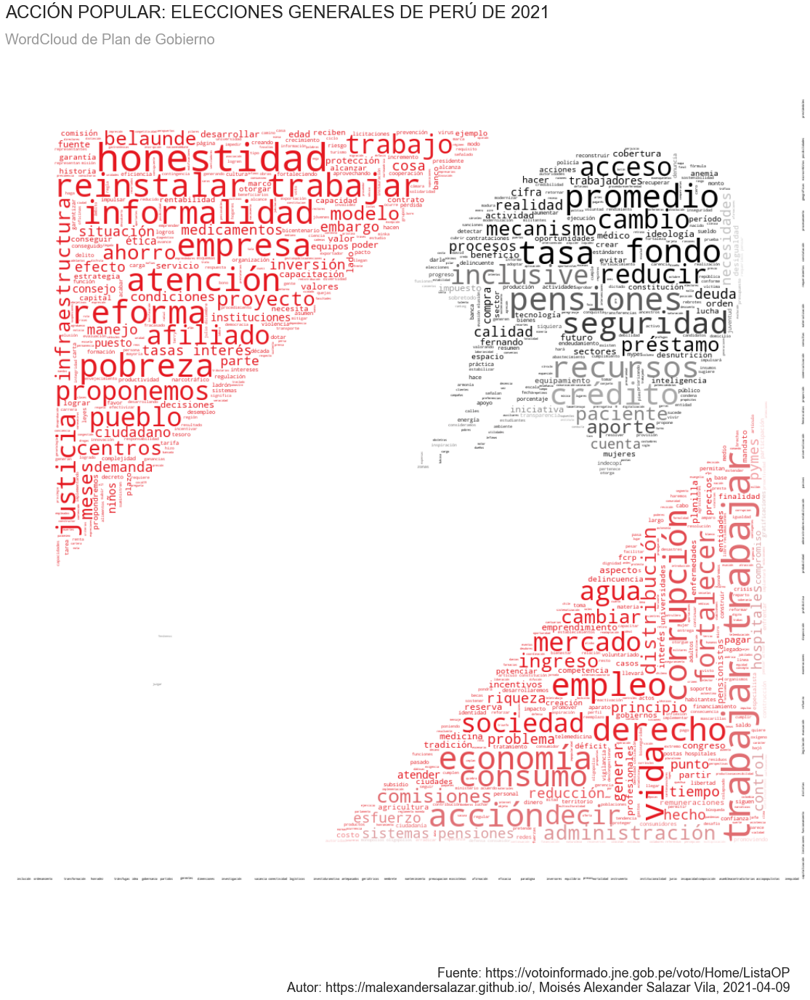

Text Size (Clean): 249079
Words Count (Clean): 26361

empresas: 181 veces (0.69 %)
inversión: 166 veces (0.63 %)
agua: 142 veces (0.54 %)



<Figure size 432x288 with 0 Axes>

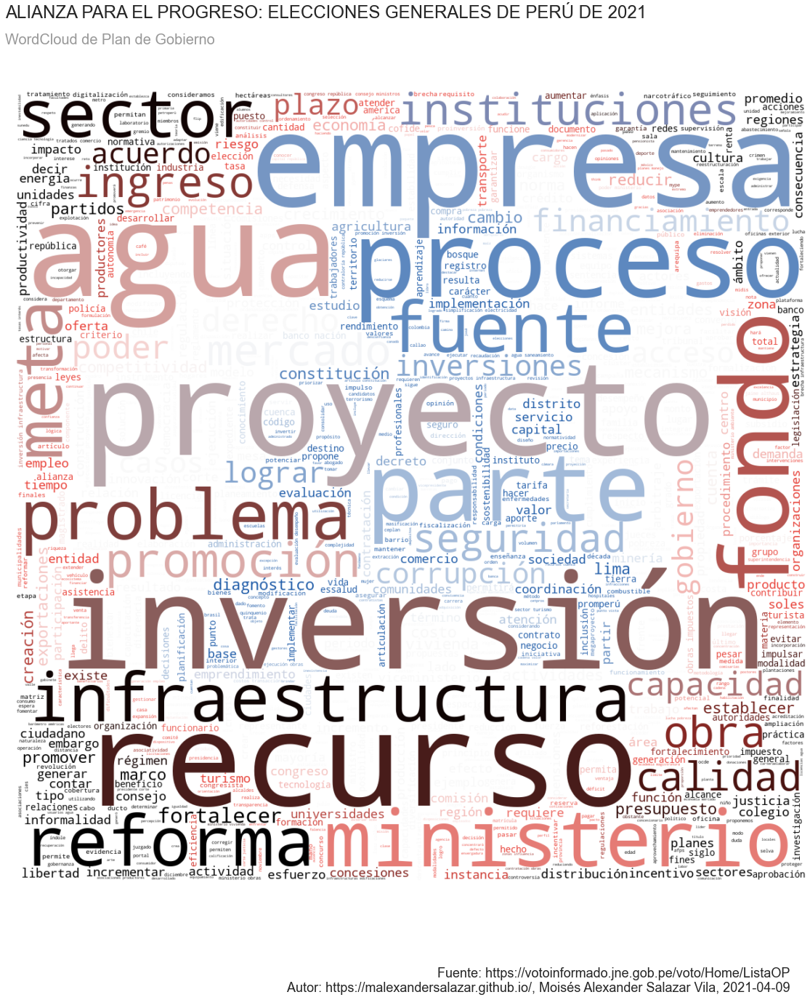

Text Size (Clean): 19725
Words Count (Clean): 2024

inversión: 17 veces (0.84 %)
infraestructura: 16 veces (0.79 %)
protección: 13 veces (0.64 %)



<Figure size 432x288 with 0 Axes>

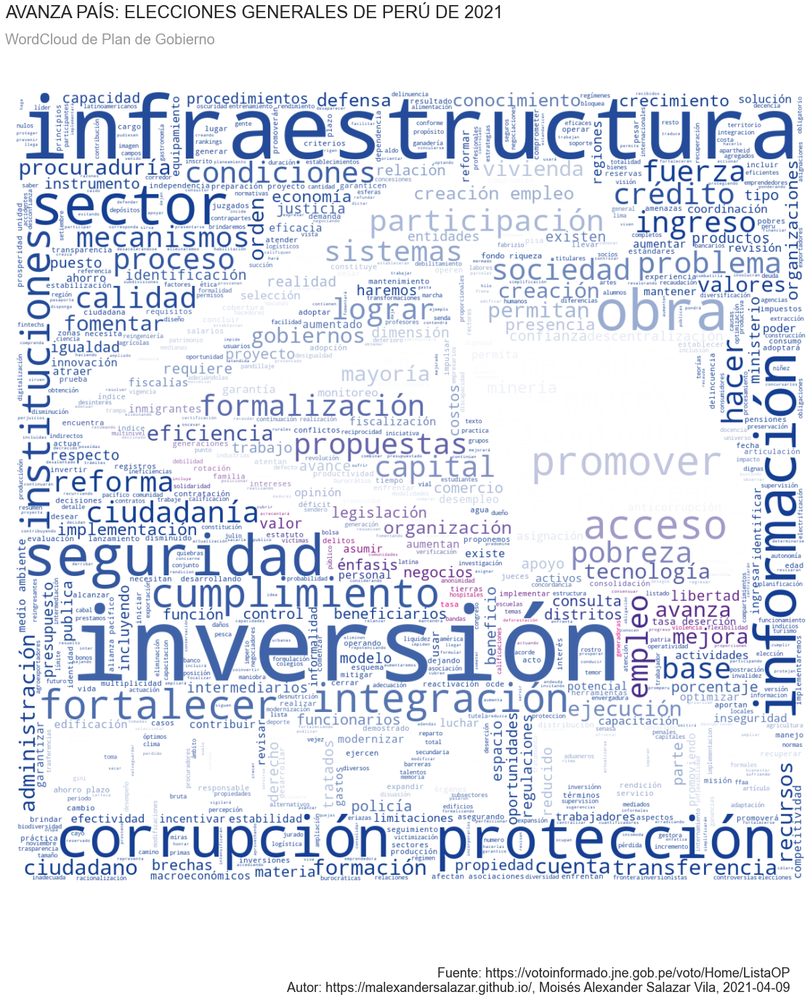

Text Size (Clean): 68416
Words Count (Clean): 6884

ministerio: 87 veces (1.26 %)
presupuesto: 73 veces (1.06 %)
instituto: 65 veces (0.94 %)



<Figure size 432x288 with 0 Axes>

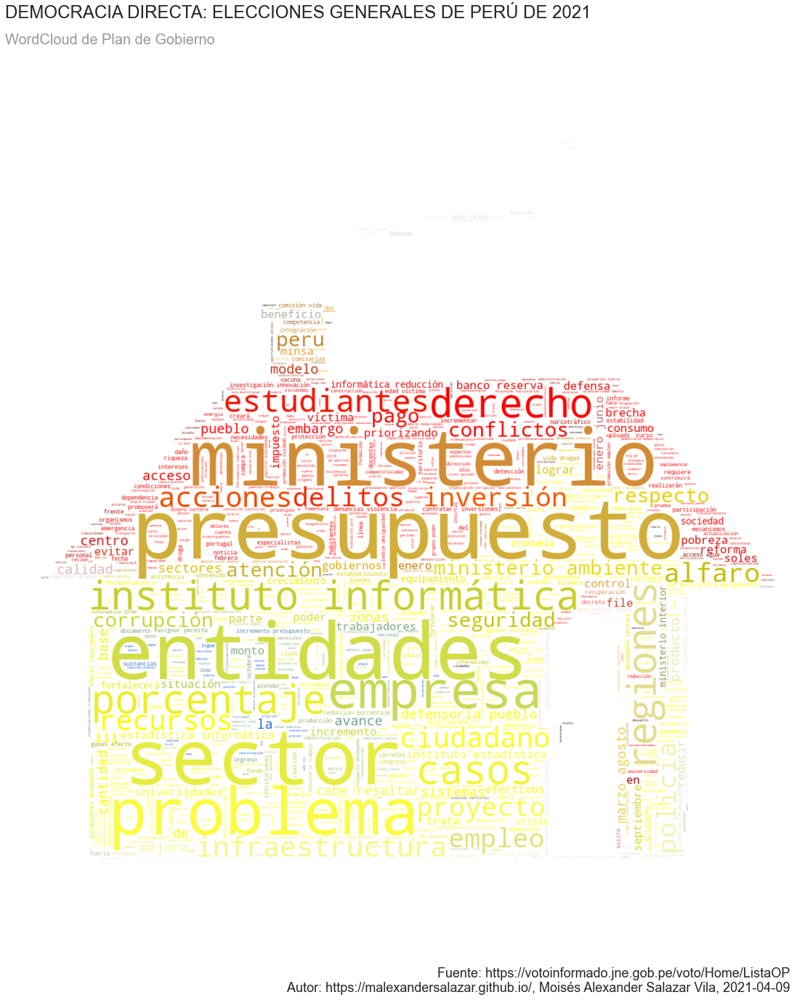

Text Size (Clean): 75462
Words Count (Clean): 7679

implementación: 84 veces (1.09 %)
incremento: 54 veces (0.7 %)
porcentaje: 52 veces (0.68 %)



<Figure size 432x288 with 0 Axes>

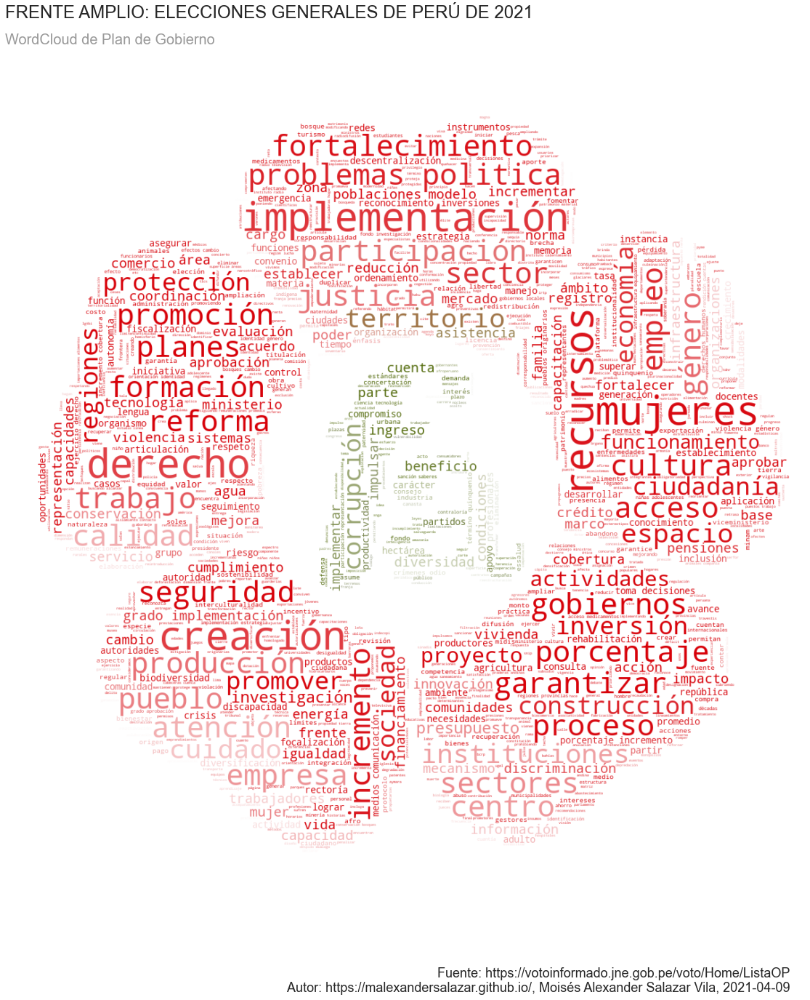

Text Size (Clean): 92692
Words Count (Clean): 9719

pobreza: 55 veces (0.57 %)
sector: 51 veces (0.52 %)
acceso: 45 veces (0.46 %)



<Figure size 432x288 with 0 Axes>

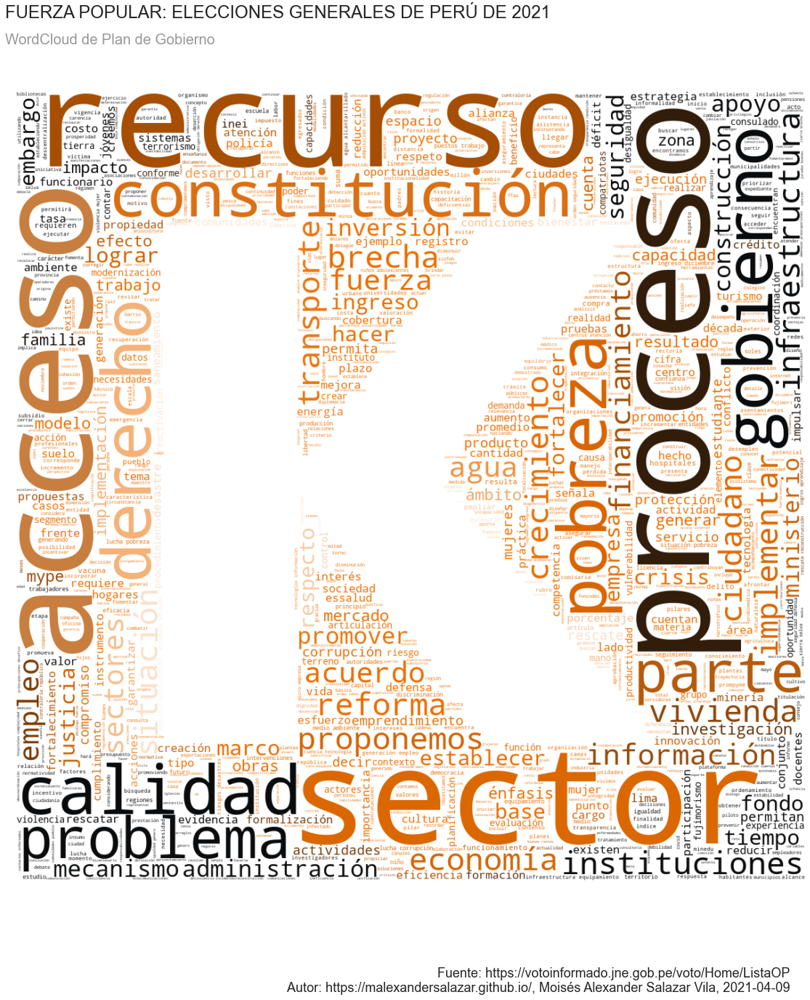

Text Size (Clean): 85417
Words Count (Clean): 8668

derechos: 76 veces (0.88 %)
fortalecer: 50 veces (0.58 %)
capacidades: 48 veces (0.55 %)



<Figure size 432x288 with 0 Axes>

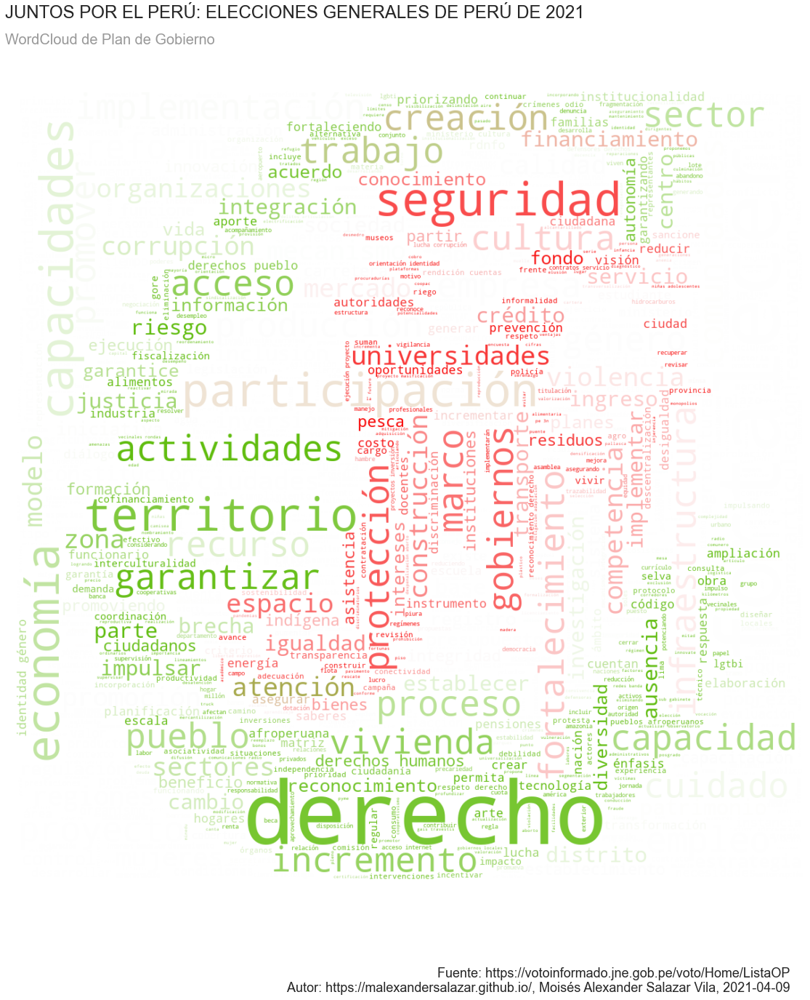

Text Size (Clean): 154082
Words Count (Clean): 15883

calidad: 112 veces (0.71 %)
vida: 80 veces (0.5 %)
acceso: 79 veces (0.5 %)



<Figure size 432x288 with 0 Axes>

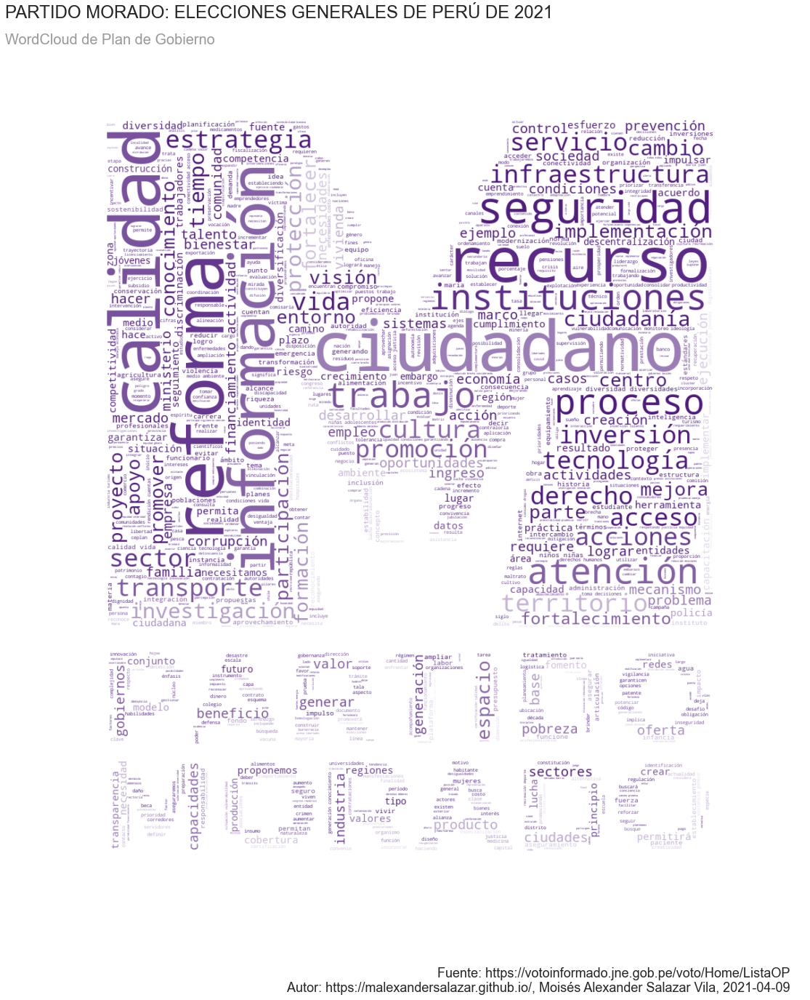

Text Size (Clean): 59516
Words Count (Clean): 6303

proyectos: 32 veces (0.51 %)
reforma: 31 veces (0.49 %)
fortalecer: 29 veces (0.46 %)



<Figure size 432x288 with 0 Axes>

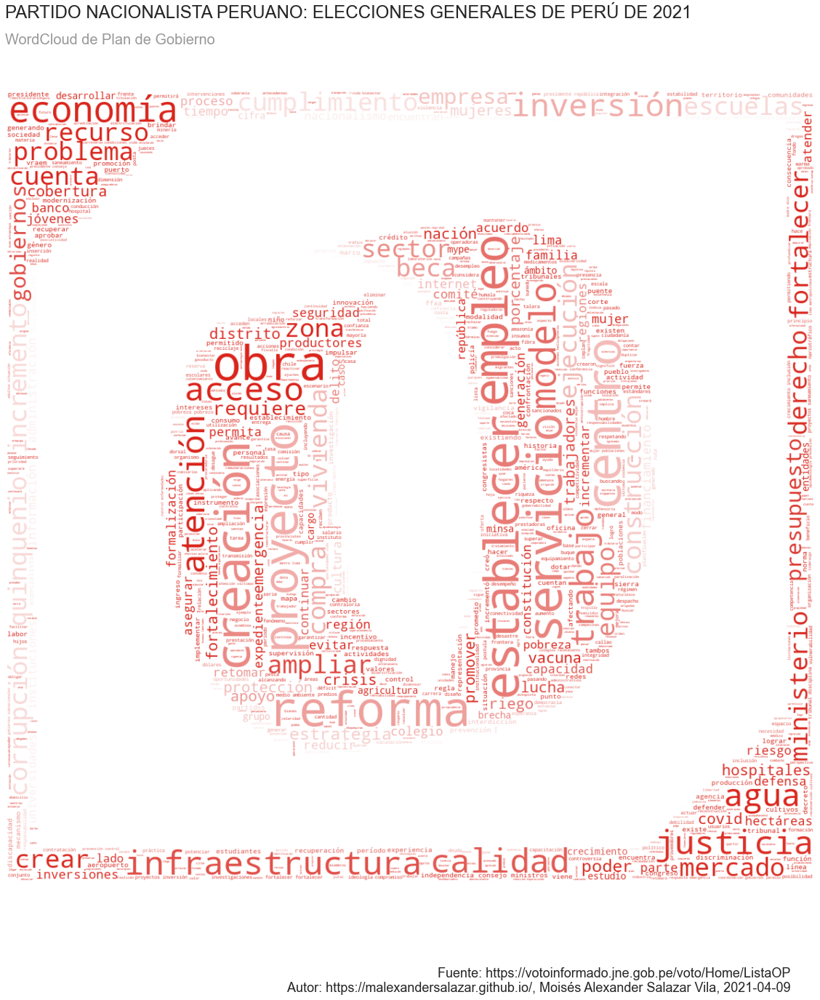

Text Size (Clean): 18305
Words Count (Clean): 1942

derechos: 52 veces (2.68 %)
convención: 39 veces (2.01 %)
humanos: 31 veces (1.6 %)



<Figure size 432x288 with 0 Axes>

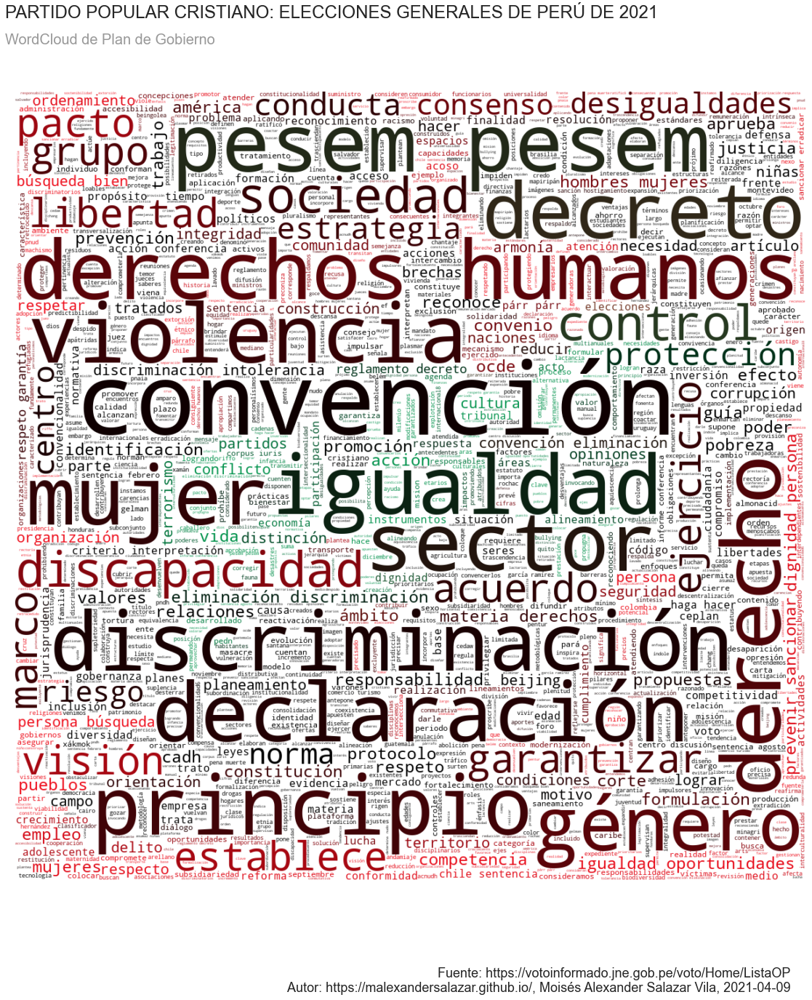

Text Size (Clean): 70972
Words Count (Clean): 7650

empresas: 50 veces (0.65 %)
sociedad: 44 veces (0.58 %)
recursos: 43 veces (0.56 %)



<Figure size 432x288 with 0 Axes>

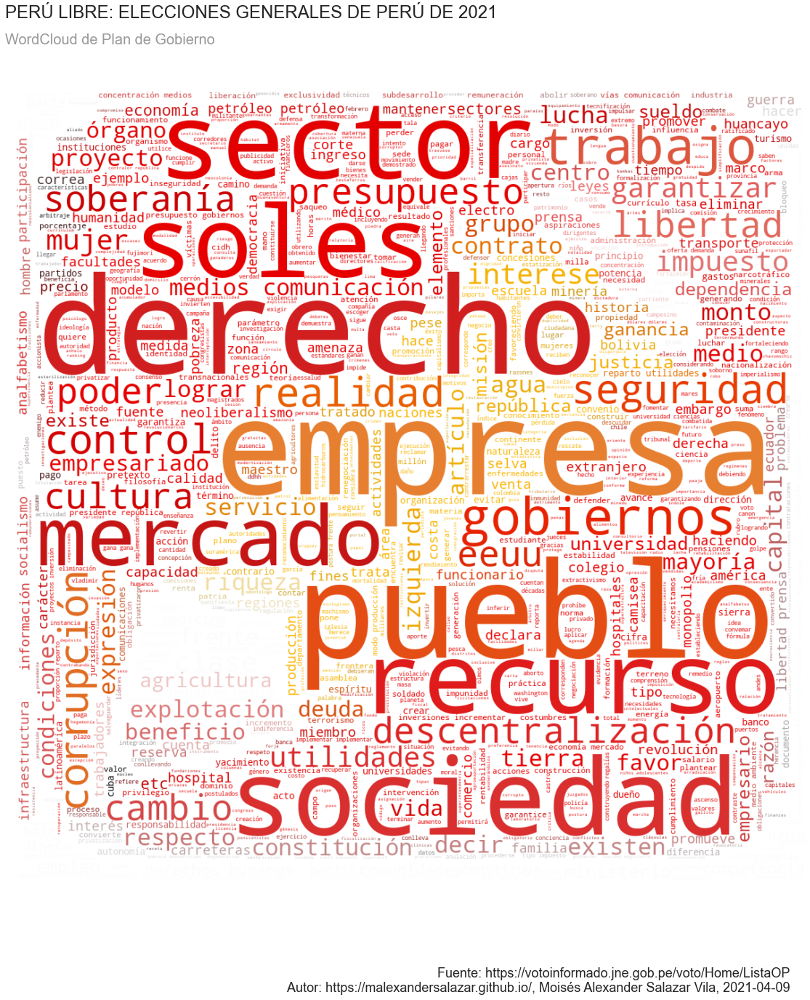

Text Size (Clean): 175021
Words Count (Clean): 18286

justicia: 146 veces (0.8 %)
derechos: 104 veces (0.57 %)
infraestructura: 96 veces (0.52 %)



<Figure size 432x288 with 0 Axes>

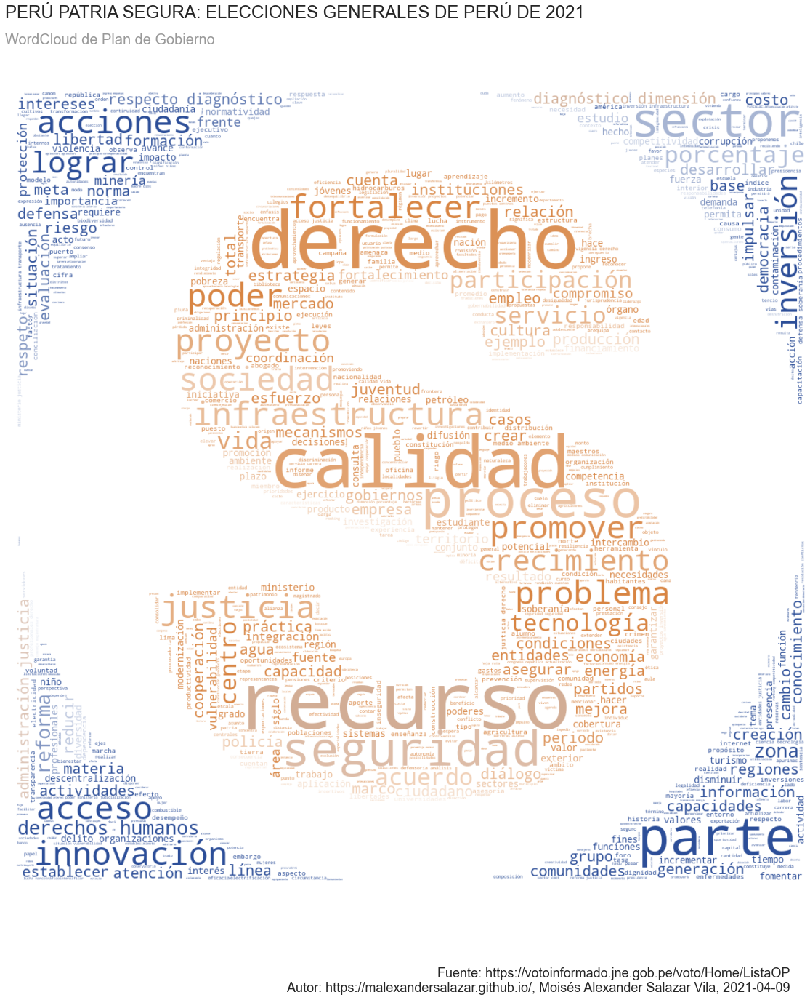

Text Size (Clean): 86639
Words Count (Clean): 9260

creación: 66 veces (0.71 %)
empresas: 61 veces (0.66 %)
economía: 54 veces (0.58 %)



<Figure size 432x288 with 0 Axes>

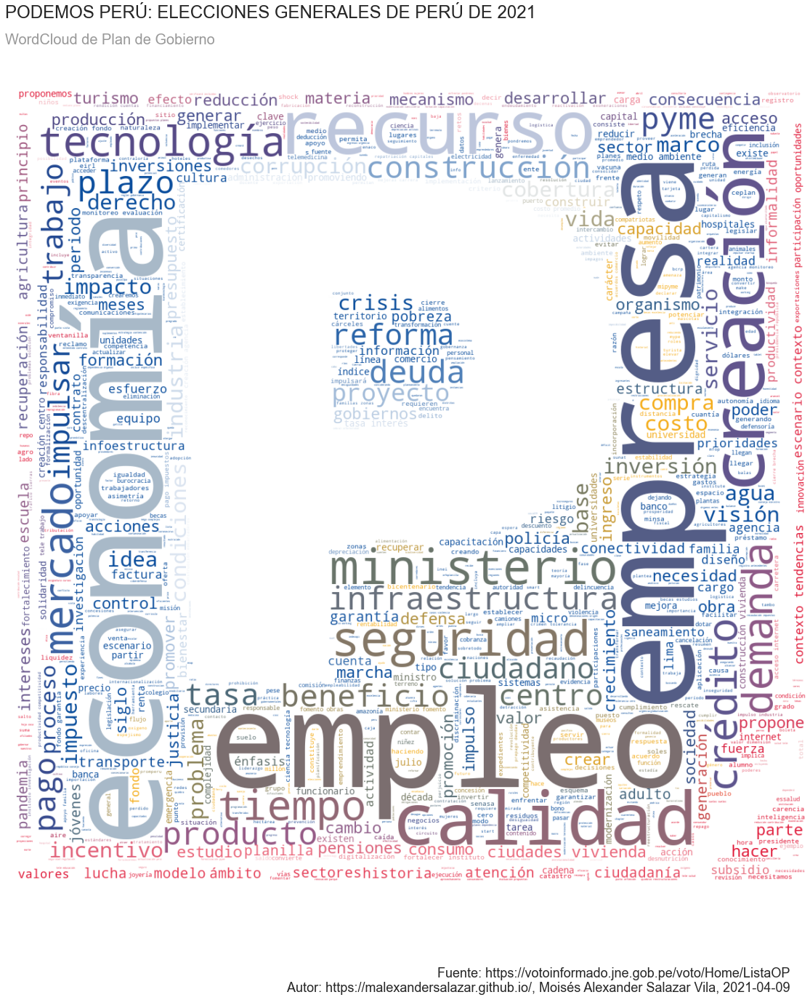

Text Size (Clean): 23301
Words Count (Clean): 2330

productos: 21 veces (0.9 %)
calidad: 18 veces (0.77 %)
zonas: 18 veces (0.77 %)



<Figure size 432x288 with 0 Axes>

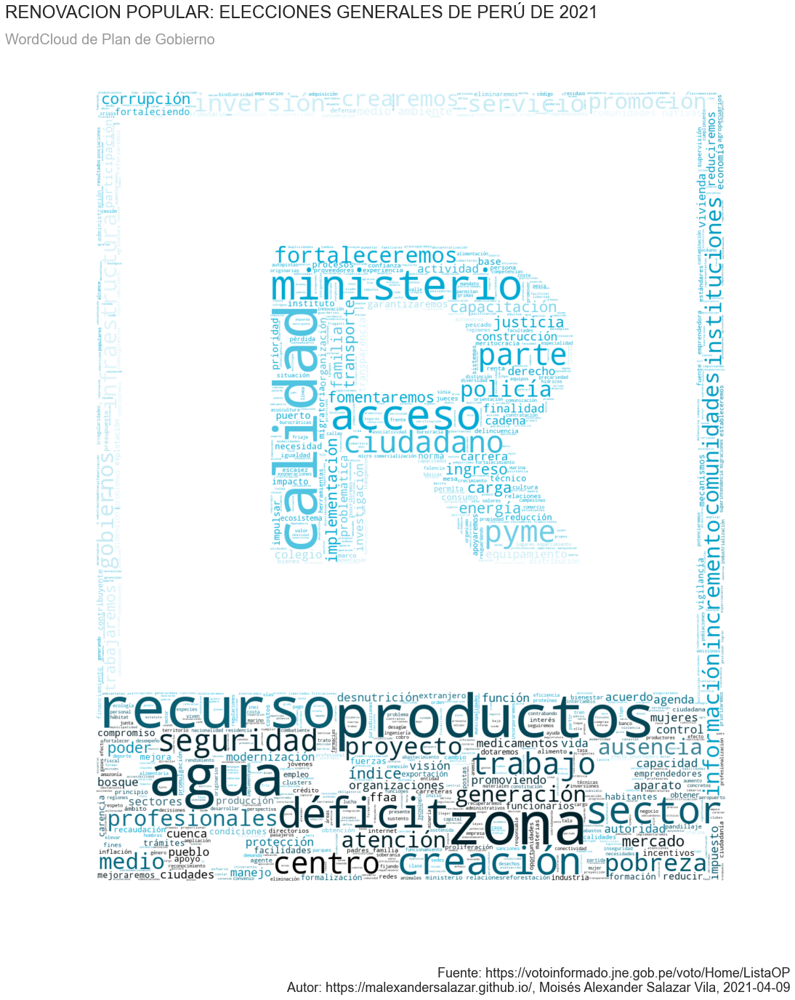

Text Size (Clean): 161411
Words Count (Clean): 16690

sector: 89 veces (0.53 %)
porcentaje: 89 veces (0.53 %)
recursos: 84 veces (0.5 %)



<Figure size 432x288 with 0 Axes>

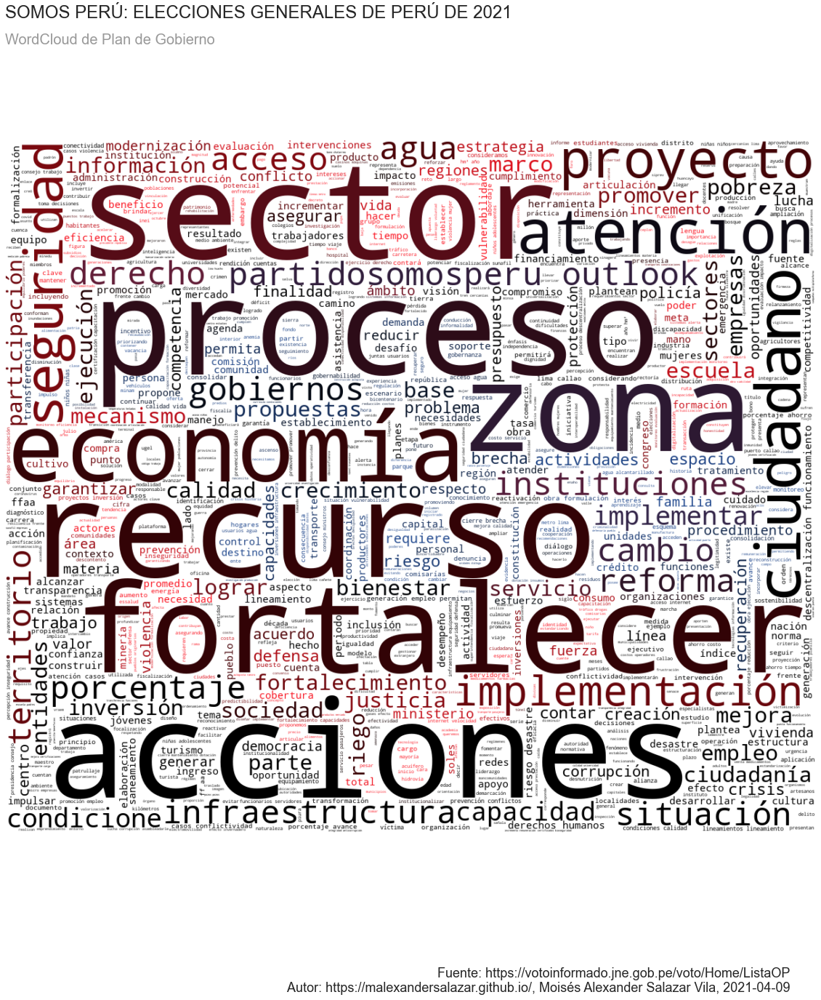

Text Size (Clean): 35050
Words Count (Clean): 3578

calidad: 28 veces (0.78 %)
infraestructura: 26 veces (0.73 %)
instituciones: 23 veces (0.64 %)



<Figure size 432x288 with 0 Axes>

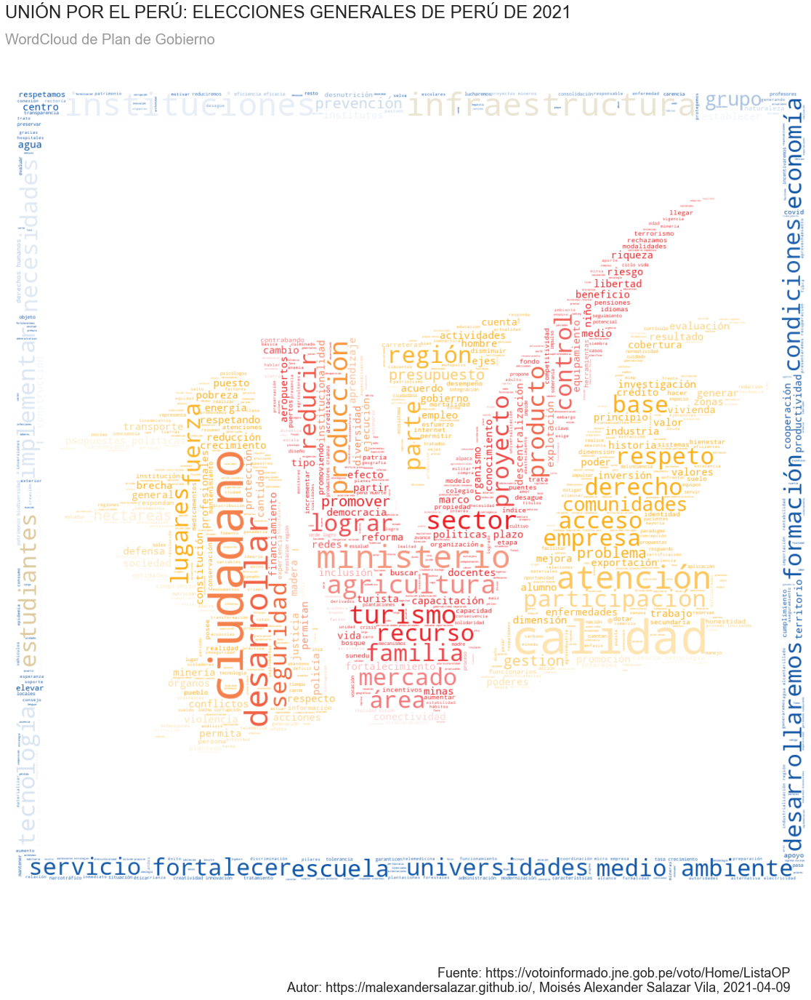

Text Size (Clean): 157614
Words Count (Clean): 16142

problemas: 118 veces (0.73 %)
inversión: 93 veces (0.58 %)
proyectos: 87 veces (0.54 %)



<Figure size 432x288 with 0 Axes>

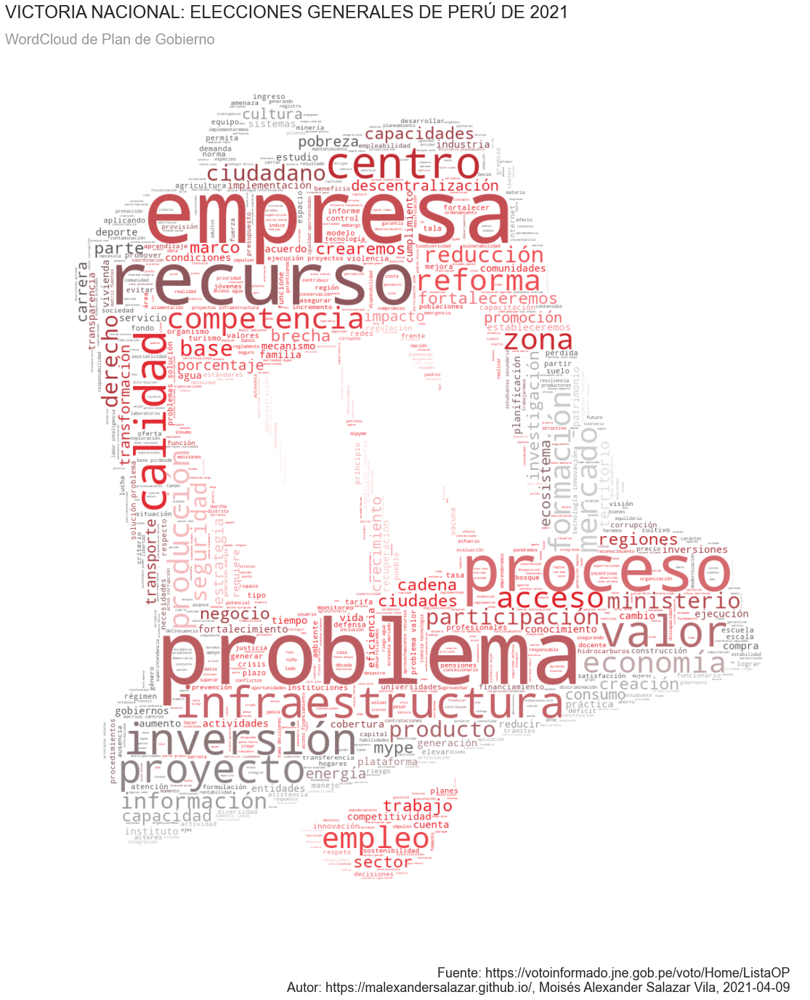

In [8]:
# Eliminando archivo generado para el Markdown de las imágenes
if os.path.exists("../dist/_images.txt"):
    os.remove("../dist/_images.txt")

for i in np.arange(len(inputs)):
    showCloud(inputs[i][0],inputs[i][1], _documents[i][1], _documents[i][2], _documents[i][3], _documents[i][4])